In [1]:

import numpy as np
import math
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as utils

#E(2)-steerable CNNs - librar"y:
from e2cnn import gspaces    
from e2cnn import nn as G_CNN   
import e2cnn

#Plotting in 2d/3d:~
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.patches import Ellipse
from matplotlib.colors import Normalize
from matplotlib import cm
from mpl_toolkits.axes_grid1 import make_axes_locatable

#Tools:
import datetime
import sys
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

sys.path.append('../../')
#Own files:
import Kernel_and_GP_tools as GP
import My_Tools
import EquivDeepSets 
import Equivariance_Tester 
import Training
from Cov_Converter import cov_converter
import Decoder_Models as models
import Architectures
import CNP.CNP_Model as CNP_Model
import EquivCNP
import Tasks.GP_Data.GP_loader as DataLoader
import Plots.GP_div_free.Evaluation_Functions as Eval
from Tasks.GP_Data.GP_sampler import Cyclic_GP_Sampler

#HYPERPARAMETERS and set seed:
torch.set_default_dtype(torch.float)
if torch.cuda.is_available():
    DEVICE = torch.device("cuda:0")  
    print("Running on the GPU")
else:
    DEVICE = torch.device("cpu")
    print("Running on the CPU")

Running on the CPU


In [2]:
FILEPATH="../../Tasks/GP_Data/"
#rbf_dataset=DataLoader.give_GP_data_set(5,30,'rbf','test',file_path=FILEPATH)
#div_dataset=DataLoader.give_GP_data_set(5,30,'div_free','test',file_path=FILEPATH)
#curl_dataset=DataLoader.give_GP_data_set(5,30,'curl_free','test',file_path=FILEPATH)

n_grid_points=30

rbf_GP_parameters={'l_scale':5.,
'sigma_var': 10., 
'kernel_type':"rbf"}
div_GP_parameters={'l_scale':5.,
'sigma_var': 10., 
'kernel_type':"div_free"}
curl_GP_parameters={'l_scale':5.,
'sigma_var': 10., 
'kernel_type':"curl_free"}


Iteration:  0
Iteration:  0
Iteration:  0


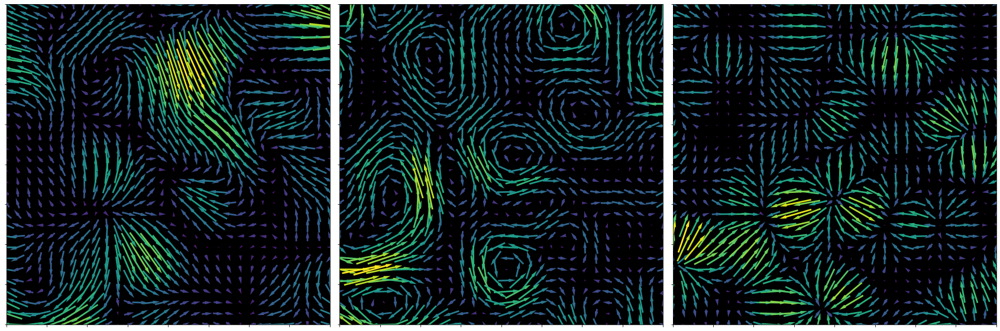

In [3]:
fig, ax=plt.subplots(nrows=1,ncols=3,figsize=(3*10,10))
X_Target,Y_Target=Cyclic_GP_Sampler(1,-10,10,n_grid_points,obs_noise=0.,**rbf_GP_parameters,cyclic=False)
scale=3.5
ax[0]=Eval.plot_context_and_VF(ax[0],X_Target=X_Target[0],Y_Target=Y_Target[0],scale=scale)
#ax[0].set_title("A")

X_Target,Y_Target=Cyclic_GP_Sampler(1,-10,10,n_grid_points,obs_noise=0.,**div_GP_parameters,cyclic=False)
scale=0.6
ax[1]=Eval.plot_context_and_VF(ax[1],X_Target=X_Target[0],Y_Target=Y_Target[0],scale=scale)


X_Target,Y_Target=Cyclic_GP_Sampler(1,-10,10,n_grid_points,obs_noise=0.,**curl_GP_parameters,cyclic=False)
scale=0.6
ax[2]=Eval.plot_context_and_VF(ax[2],X_Target=X_Target[0],Y_Target=Y_Target[0],scale=scale)

for i in range(3):
        ax[i].set_xlim([-10,10])
        ax[i].set_ylim([-10,10])
        ax[i].set_yticklabels([])
        ax[i].set_xticklabels([])
plt.subplots_adjust(wspace=0.03, hspace=0.)
plt.savefig("GP_VF_Examples_2.pdf",pad_inches=0.,bbox_inches='tight')


In [4]:
test_dataset=DataLoader.give_GP_data_set(5,30,'div_free','test',file_path=FILEPATH)


In [42]:
#Plot predictions.
def turn_90_degrees(X):
    return(torch.stack([-X[:,1],X[:,0]],dim=1))
def turn_270_degrees(X):
    return(torch.stack([X[:,1],-X[:,0]],dim=1))
scale=10.
n_grid_points=10
fig, ax=plt.subplots(ncols=2,nrows=1,figsize=(2*10,10))

X,Y=Cyclic_GP_Sampler(1,-3,3,n_grid_points,obs_noise=0.,**div_GP_parameters,cyclic=False)
n_context=10
X=X.squeeze()
Y=Y.squeeze()
inds=torch.randperm(X_Target.shape[0])
#batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)

X_Context=X[inds[:n_context],:]
Y_Context=Y[inds[:n_context],:]
X_Target=X[inds[n_context:],:]
Y_Target=Y[inds[n_context:],:]

Predict_GP,Covs_GP,Vars_GP=GP.GP_inference(X_Context,Y_Context,X_Target,**div_GP_parameters)


ax[0].quiver(Predict_GP[:,0],Predict_GP[:,1],Y_Target[:,0],Y_Target[:,1],
            pivot='mid',scale_units='width',scale=scale,headlength=4, headwidth = 2,width=0.005,alpha=1)
ax[0].quiver(X_Context[:,0],X_Context[:,1],Y_Context[:,0],Y_Context[:,1], color='red',
            pivot='mid',scale_units='width',scale=scale,headlength=4, headwidth = 2,width=0.005,alpha=1)
X_Context_rot=turn_90_degrees(X_Context)
Y_Context_rot=turn_90_degrees(Y_Context)
Predict_GP_rot,Covs_GP_rot,Vars_GP_rot=GP.GP_inference(X_Context_rot,Y_Context_rot,X_Target_rot,**div_GP_parameters)

ax[1].quiver(Predict_GP_rot[:,0],Predict_GP_rot[:,1],Y_Target_rot[:,0],Y_Target_rot[:,1],
            pivot='mid',scale_units='width',scale=scale,headlength=4, headwidth = 2,width=0.005,alpha=1)
Eval.plot_Covs(ax[0],X_Target,Covs_GP,scale=20,x1_lim=[-10,10],x2_lim=[-10,10],alpha=1.,facecolor='orange',edgecolor='grey')
Eval.plot_Covs(ax[1],X_Target_rot,Covs_GP_rot,scale=20,x1_lim=[-10,10],x2_lim=[-10,10],alpha=1.,facecolor='orange',edgecolor='grey')

for it in range(2):
    ax[it].set_yticklabels([])
    ax[it].set_xticklabels([])
    ax[it].set_xlim([-3.2,3.2])
    ax[it].set_ylim([-3.2,3.2])



Iteration:  0


NameError: name 'Cov_GP' is not defined

In [7]:


turn_90_degrees(X_Target)

tensor([[-3.0000,  0.3333],
        [-2.3333, -3.0000],
        [ 3.0000,  2.3333],
        [ 1.0000, -2.3333],
        [ 0.3333,  3.0000],
        [ 1.0000,  0.3333],
        [-1.6667,  2.3333],
        [ 3.0000,  0.3333],
        [-1.6667, -2.3333],
        [ 2.3333,  1.6667],
        [-3.0000,  1.0000],
        [ 2.3333,  3.0000],
        [-1.6667,  1.6667],
        [-1.0000,  2.3333],
        [ 1.6667, -3.0000],
        [-3.0000,  1.6667],
        [ 3.0000, -2.3333],
        [ 3.0000,  1.6667],
        [ 1.6667,  1.0000],
        [-2.3333,  2.3333],
        [ 1.6667, -2.3333],
        [ 1.0000,  2.3333],
        [ 3.0000, -1.6667],
        [-0.3333, -2.3333],
        [ 1.6667,  2.3333],
        [-1.0000,  3.0000],
        [-1.0000, -0.3333],
        [ 1.0000, -0.3333],
        [ 2.3333, -0.3333],
        [ 3.0000, -1.0000],
        [ 1.0000,  1.6667],
        [-1.0000, -1.0000],
        [ 2.3333, -1.0000],
        [ 0.3333,  2.3333],
        [-0.3333, -1.6667],
        [-2.3333, -1

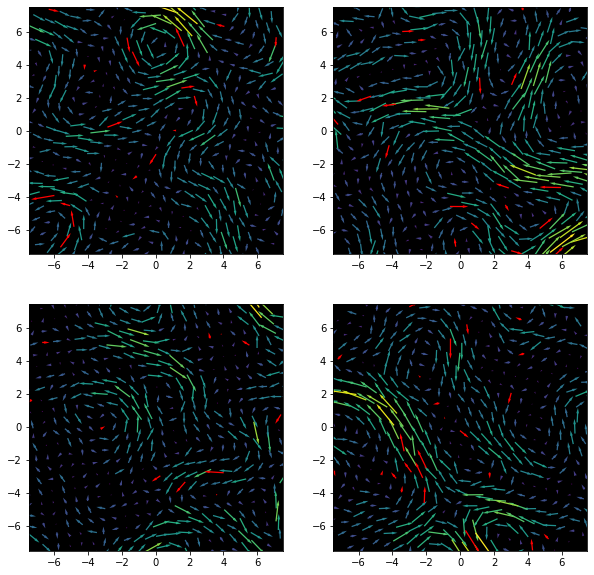

In [14]:
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(10,10))
scale=0.7
for i in range(2):
    for j in range(2):
        batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)
        X_Context=batch_X_Context.squeeze()
        Y_Context=batch_Y_Context.squeeze()
        X_Target=batch_X_Target.squeeze()
        Y_Target=batch_Y_Target.squeeze()
        ax[i][j]=Eval.plot_context_and_VF(ax[i][j],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Y_Target,scale=scale)
        ax[i][j].set_xlim([-7.5,7.5])
        ax[i][j].set_ylim([-7.5,7.5])

#plt.savefig("GP_div_free_samples.pdf",pad_inches=0.,bbox_inches='tight')


In [15]:
#train_dict=torch.load('../../Experiments/GP/Saved_Models/CNP_final_1_2020_09_06_22_59',map_location=torch.device('cpu'))
train_dict=torch.load('../../Experiments/GP/Saved_Models/Illustration_Models/D8_choice_first_2020_09_02_18_07',map_location=torch.device('cpu'))
CNP=EquivCNP.EquivCNP.create_model_from_dict(train_dict['CNP_dict'])
#CNP=CNP_Model.ConditionalNeuralProcess.create_model_from_dict(train_dict['CNP_dict'])


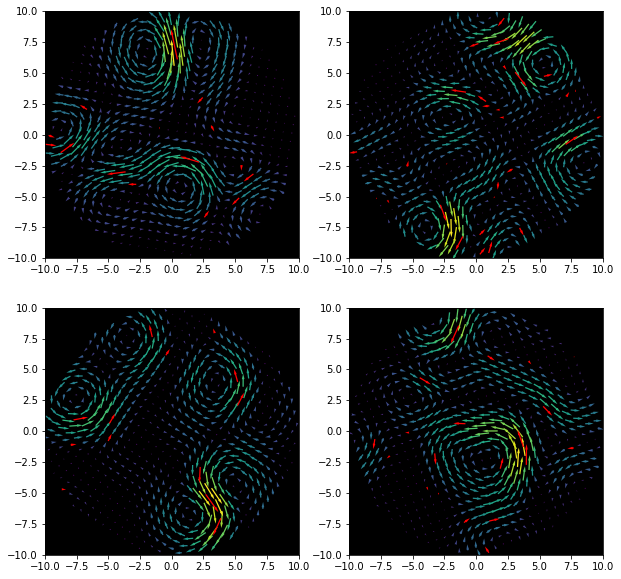

In [16]:
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(10,10))
scale=0.7
for i in range(2):
    for j in range(2):
        batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)
        X_Context=batch_X_Context.squeeze()
        Y_Context=batch_Y_Context.squeeze()
        X_Target=batch_X_Target.squeeze()
        Predict,_=CNP(batch_X_Context,batch_Y_Context,batch_X_Target)
        ax[i][j]=Eval.plot_context_and_VF(ax[i][j],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Predict[0].detach(),scale=scale)
plt.savefig("Example_predictions_EquivCNP.png",pad_inches=0.,bbox_inches='tight')


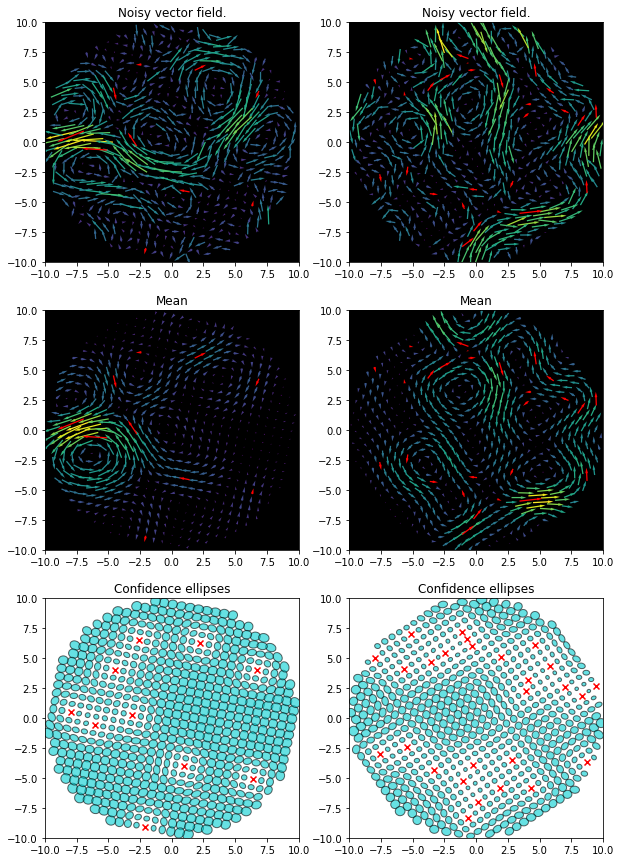

In [17]:
n_samples=2
fig,ax=plt.subplots(nrows=3,ncols=n_samples,figsize=(10,15))
scale=0.7
for j in range(n_samples):
    batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)
    X_Context=batch_X_Context.squeeze()
    Y_Context=batch_Y_Context.squeeze()
    X_Target=batch_X_Target.squeeze()
    Y_Target=batch_Y_Target.squeeze()
    batch_Predict,batch_Covs=CNP(batch_X_Context,batch_Y_Context,batch_X_Target)
    Predict=batch_Predict.squeeze().detach()
    Covs=batch_Covs.squeeze().detach()
    ax[0][j]=Eval.plot_context_and_VF(ax[0][j],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Y_Target,scale=scale)
    ax[0][j].set_title("Noisy vector field.")
    ax[1][j]=Eval.plot_context_and_VF(ax[1][j],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Predict,scale=scale)
    ax[1][j].set_title("Mean")
    ax[2][j]=Eval.compare_predict_vs_truth(ax[2][j],X_Context=X_Context,X_Target=X_Target,Predict_1=Y_Target,Predict_2=None,Cov_Mat=Covs,scale=scale*2.5,      color='darkturquoise',diff_color='orange')
    ax[2][j].set_title("Confidence ellipses")

#plt.savefig("EquivCNP_Predictions.pdf",pad_inches=0.,bbox_inches='tight')



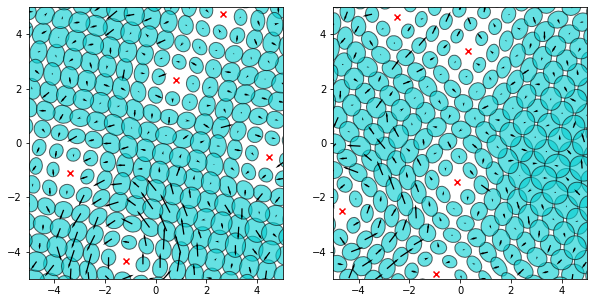

In [20]:
n_samples=2
fig,ax=plt.subplots(nrows=1,ncols=n_samples,figsize=(10,5))
scale=0.7
for j in range(n_samples):
    batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1,cont_in_target=False)
    X_Context=batch_X_Context.squeeze()
    Y_Context=batch_Y_Context.squeeze()
    X_Target=batch_X_Target.squeeze()
    Y_Target=batch_Y_Target.squeeze()
    batch_Predict,batch_Covs=CNP(batch_X_Context,batch_Y_Context,batch_X_Target)
    Predict=batch_Predict.squeeze().detach()
    Covs=batch_Covs.squeeze().detach()
    ax[j]=Eval.compare_predict_vs_truth(ax[j],X_Context=X_Context,X_Target=X_Target,Predict_1=Y_Target,Predict_2=Predict,Cov_Mat=Covs,scale=scale*2,      color='darkturquoise',diff_color='black',x1_lim=[-5,5],x2_lim=[-5,5])
#plt.savefig("Insecurity_plot_1.pdf",pad_inches=0.,bbox_inches='tight')

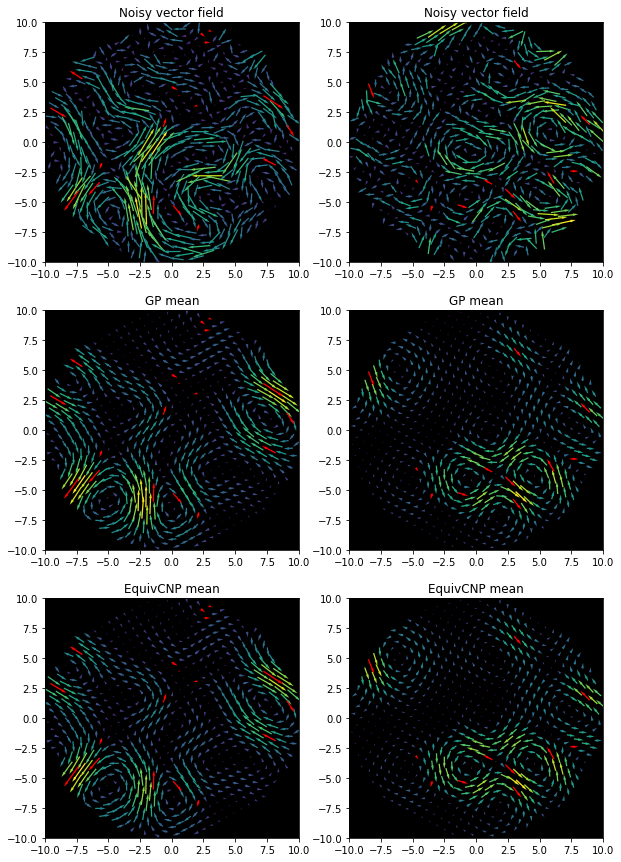

In [19]:
n_samples=2
fig,ax=plt.subplots(nrows=3,ncols=n_samples,figsize=(10,15))
scale=0.7
for j in range(n_samples):
    batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)
    X_Context=batch_X_Context.squeeze()
    Y_Context=batch_Y_Context.squeeze()
    X_Target=batch_X_Target.squeeze()
    Y_Target=batch_Y_Target.squeeze()
    batch_Predict,batch_Covs=CNP(batch_X_Context,batch_Y_Context,batch_X_Target)
    Predict=batch_Predict.squeeze().detach()
    Covs=batch_Covs.squeeze().detach()
    GP_parameters={'l_scale':5.,
        'sigma_var': 10., 
        'kernel_type':"div_free",
        'obs_noise':0.02}
    Predict_GP,Covs_GP,Vars_GP=GP.GP_inference(X_Context,Y_Context,X_Target,**GP_parameters)
    Covs_GP=My_Tools.Get_Block_Diagonal(Covs_GP,size=2)

    ax[0][j]=Eval.plot_context_and_VF(ax[0][j],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Y_Target,scale=scale)
    ax[0][j].set_title("Noisy vector field")

    ax[1][j]=Eval.plot_context_and_VF(ax[1][j],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Predict_GP,scale=scale)
    ax[1][j].set_title("GP mean")
    
    ax[2][j]=Eval.plot_context_and_VF(ax[2][j],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Predict,scale=scale)
    ax[2][j].set_title("EquivCNP mean")

#plt.savefig("Compare_with_GP.pdf",pad_inches=0.,bbox_inches='tight')

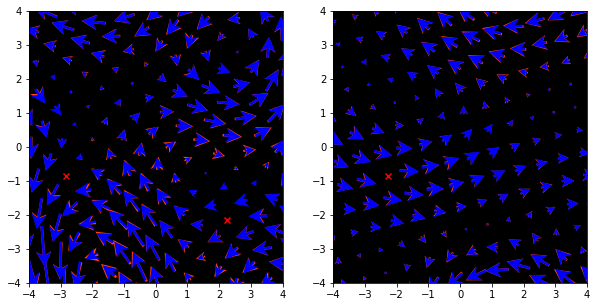

In [8]:
n_samples=2
fig,ax=plt.subplots(nrows=1,ncols=n_samples,figsize=(10,5))
scale=0.7
for j in range(n_samples):
    batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)
    X_Context=batch_X_Context.squeeze()
    Y_Context=batch_Y_Context.squeeze()
    X_Target=batch_X_Target.squeeze()
    Y_Target=batch_Y_Target.squeeze()
    batch_Predict,batch_Covs=CNP(batch_X_Context,batch_Y_Context,batch_X_Target)
    Predict=batch_Predict.squeeze().detach()
    Covs=batch_Covs.squeeze().detach()
    GP_parameters={'l_scale':5.,
        'sigma_var': 10., 
        'kernel_type':"div_free",
        'obs_noise':0.02}
    Predict_GP,Covs_GP,Vars_GP=GP.GP_inference(X_Context,Y_Context,X_Target,**GP_parameters)
    Covs_GP=My_Tools.Get_Block_Diagonal(Covs_GP,size=2)
    ax[j]=Eval.compare_VF(ax[j],X_Context=X_Context,X_Target=X_Target,Predict_1=Predict_GP,Predict_2=Predict,scale=scale,x1_lim=[-4,4],x2_lim=[-4,4],color_1='orangered',color_2='blue')
    ax[j].set_facecolor('black')

#plt.savefig("Compare_with_GP_zoom.pdf",pad_inches=0.,bbox_inches='tight')

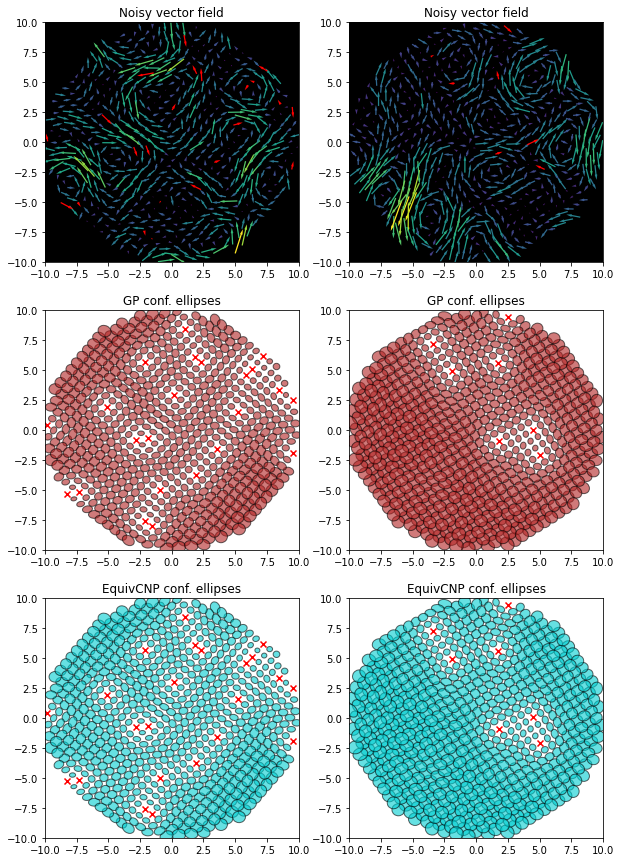

In [9]:
n_samples=2
fig,ax=plt.subplots(nrows=3,ncols=n_samples,figsize=(10,15))
scale=0.7
for j in range(n_samples):
    batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)
    X_Context=batch_X_Context.squeeze()
    Y_Context=batch_Y_Context.squeeze()
    X_Target=batch_X_Target.squeeze()
    Y_Target=batch_Y_Target.squeeze()
    batch_Predict,batch_Covs=CNP(batch_X_Context,batch_Y_Context,batch_X_Target)
    Predict=batch_Predict.squeeze().detach()
    Covs=batch_Covs.squeeze().detach()
    GP_parameters={'l_scale':5.,
        'sigma_var': 10., 
        'kernel_type':"div_free",
        'obs_noise':0.02}
    Predict_GP,Covs_GP,Vars_GP=GP.GP_inference(X_Context,Y_Context,X_Target,**GP_parameters)
    Covs_GP=My_Tools.Get_Block_Diagonal(Covs_GP,size=2)

    
    ax[0][j]=Eval.plot_context_and_VF(ax[0][j],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Y_Target,scale=scale)
    ax[0][j].set_title("Noisy vector field")

    ax[1][j]=Eval.compare_predict_vs_truth(ax[1][j],X_Context=X_Context,X_Target=X_Target,Predict_1=Y_Target,Predict_2=None,Cov_Mat=Covs,scale=scale*2,color='firebrick')
    ax[1][j].set_title("GP conf. ellipses")

    ax[2][j]=Eval.compare_predict_vs_truth(ax[2][j],X_Context=X_Context,X_Target=X_Target,Predict_1=Y_Target,Predict_2=None,Cov_Mat=Covs,scale=scale*2,     color='darkturquoise')
    ax[2][j].set_title("EquivCNP conf. ellipses")

#plt.savefig("Compare_Covs_with_GP.pdf",pad_inches=0.,bbox_inches='tight')

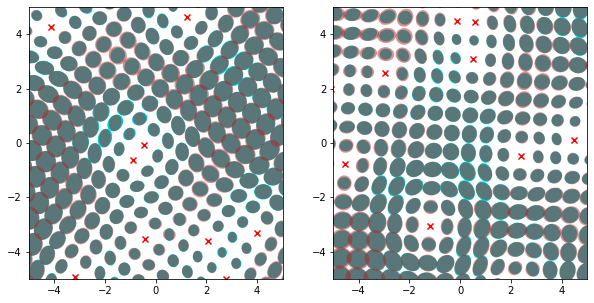

In [10]:
n_samples=2
fig,ax=plt.subplots(nrows=1,ncols=n_samples,figsize=(10,5))
scale=0.7
for j in range(n_samples):
    batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)
    X_Context=batch_X_Context.squeeze()
    Y_Context=batch_Y_Context.squeeze()
    X_Target=batch_X_Target.squeeze()
    Y_Target=batch_Y_Target.squeeze()
    batch_Predict,batch_Covs=CNP(batch_X_Context,batch_Y_Context,batch_X_Target)
    Predict=batch_Predict.squeeze().detach()
    Covs=batch_Covs.squeeze().detach()
    GP_parameters={'l_scale':5.,
        'sigma_var': 10., 
        'kernel_type':"div_free",
        'obs_noise':0.02}
    Predict_GP,Covs_GP,Vars_GP=GP.GP_inference(X_Context,Y_Context,X_Target,**GP_parameters)
    Covs_GP=My_Tools.Get_Block_Diagonal(Covs_GP,size=2)
    ax[j]=Eval.diff_covs(ax[j],X_Context=X_Context,X_Target=X_Target,Cov_Mat_1=Covs_GP,Cov_Mat_2=Covs,scale=scale*2,x1_lim=[-5,5],x2_lim=[-5,5])

#plt.savefig("Cov_comparison_with_GP_Zoom_2.pdf",pad_inches=0.,bbox_inches='tight')

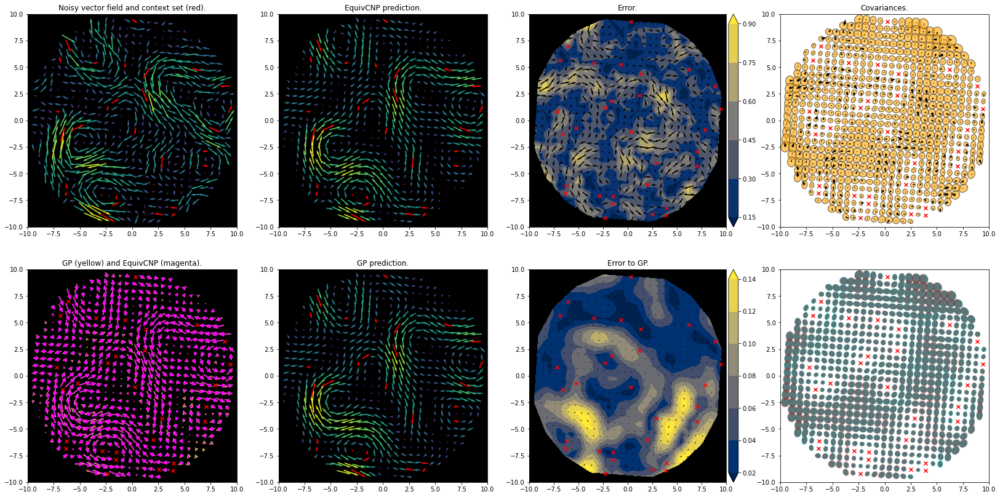

In [11]:
fig,ax=plt.subplots(nrows=2,ncols=4,figsize=(4*7,2*7))
scale=0.7
batch_X_Context,batch_Y_Context,batch_X_Target,batch_Y_Target=test_dataset.get_rand_batch(batch_size=1)
X_Context=batch_X_Context.squeeze()
Y_Context=batch_Y_Context.squeeze()
X_Target=batch_X_Target.squeeze()
Y_Target=batch_Y_Target.squeeze()
batch_Predict,batch_Covs=CNP(batch_X_Context,batch_Y_Context,batch_X_Target)
Predict=batch_Predict.squeeze().detach()
Covs=batch_Covs.squeeze().detach()
GP_parameters={'l_scale':5.,
'sigma_var': 10., 
'kernel_type':"div_free",
'obs_noise':0.02}
Predict_GP,Covs_GP,Vars_GP=GP.GP_inference(X_Context,Y_Context,X_Target,**GP_parameters)
Covs_GP=My_Tools.Get_Block_Diagonal(Covs_GP,size=2)
#R=torch.tensor([[0,-1],[1,0]],dtype=torch.get_default_dtype())
#Covs_turned=torch.matmul(R,torch.matmul(Covs,R.t()))
ax[0][0]=Eval.plot_context_and_VF(ax[0][0],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Y_Target,scale=scale)
ax[0][1]=Eval.plot_context_and_VF(ax[0][1],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Predict,scale=scale)
ax[0][2],tricontour=Eval.plot_diff(ax[0][2],X_Context=X_Context,X_Target=X_Target,Predict_1=Y_Target,Predict_2=Predict,scale=scale)
divider = make_axes_locatable(ax[0][2])
cax1 = divider.append_axes("right", size="5%", pad=0.05)
fig.colorbar(tricontour, cax=cax1)
ax[0][3]=Eval.compare_predict_vs_truth(ax[0][3],X_Context=X_Context,X_Target=X_Target,Predict_1=Y_Target,Predict_2=Predict,Cov_Mat=Covs,scale=scale*2)
ax[1][0]=Eval.compare_VF(ax[1][0],X_Context=X_Context,X_Target=X_Target,Predict_1=Predict_GP,Predict_2=Predict,scale=scale)
ax[1][1]=Eval.plot_context_and_VF(ax[1][1],X_Context=X_Context,Y_Context=Y_Context,X_Target=X_Target,Y_Target=Predict_GP,scale=scale)
ax[1][2],tricontour=Eval.plot_diff(ax[1][2],X_Context=X_Context,X_Target=X_Target,Predict_1=Predict_GP,Predict_2=Predict,scale=scale)
divider = make_axes_locatable(ax[1][2])
cax2 = divider.append_axes("right", size="5%", pad=0.05)
fig.colorbar(tricontour, cax=cax2)
ax[1][3]=Eval.diff_covs(ax[1][3],X_Context=X_Context,X_Target=X_Target,Cov_Mat_1=Covs_GP,Cov_Mat_2=Covs,scale=scale*2)
ax[0][0].set_title("Noisy vector field and context set (red).")
ax[0][1].set_title("EquivCNP prediction.")
ax[0][2].set_title("Error.")
ax[0][3].set_title("Covariances.")
ax[1][0].set_title("GP (yellow) and EquivCNP (magenta).")
ax[1][1].set_title("GP prediction.")
ax[1][2].set_title("Error to GP.")
#ax[1][3].set_title("Covariances GP (blue) vs covariances EquivCNP (red).")
#plt.savefig("EquivCNP_example_4.pdf")



In [7]:
#Quiver: scale - data units per arrow length unit
def plot_context_and_VF(ax,X_Context=None,Y_Context=None,X_Target=None,Y_Target=None,scale=20,colormap='viridis',x1_lim=[-10,10],x2_lim=[-10,10]):
    ax.set_xlim(x1_lim)
    ax.set_ylim(x2_lim)
    width=ax.get_xlim()[1]-ax.get_xlim()[0]
    if X_Target is not None and Y_Target is not None:
        ax.quiver(X_Target[:,0],X_Target[:,1],Y_Target[:,0],Y_Target[:,1],Y_Target.norm(dim=1),
        cmap=cm.get_cmap(colormap),pivot='mid',scale_units='width',scale=width*scale,headlength=4, headwidth = 2,width=0.005,alpha=1)
    if X_Context is not None and Y_Context is not None:
        ax.quiver(X_Context[:,0],X_Context[:,1],Y_Context[:,0],Y_Context[:,1],
            color='red',pivot='mid',label='Context set',scale_units='width',scale=width*scale,headlength=4, headwidth = 2,width=0.005)   
    ax.set_facecolor('black')
    return(ax)

def plot_Covs(ax,X_Target,Cov_Mat,x1_lim=None,x2_lim=None,scale=20,alpha=1.,facecolor='orange',edgecolor='grey'):
    chi_sq_quantile=math.sqrt(2.157)#corresponding to 66% ellipse, for 95%:5.99#

    if X_Target is not None and Cov_Mat is not None:
        #Get window limites for plot and set window for second plot:
        if x1_lim is not None and x2_lim is not None:
            ax.set_xlim(x1_lim)
            ax.set_ylim(x2_lim)
        #traces=Cov_Mat[:,0,0]+Cov_Mat[:,1,1]
        #min_traces=torch.min(traces).item()
        #max_traces=torch.max(traces).item()
        #colormap=cm.get_cmap('Spectral')
        #traces=np.floor(colormap.N*(traces-min_traces)/max_traces)
        
        #Go over all target points and plot ellipse of continour lines of density of distributions:
        for j in range(X_Target.size(0)):
            #Get covarinace matrix:
            A=Cov_Mat[j]
            #if len(A.size())==1:
            #    A=torch.diag(A)
            #Decompose A:
            eigen_decomp=torch.eig(A,eigenvectors=True)
            #Get the eigenvector corresponding corresponding to the largest eigenvalue:
            u=eigen_decomp[1][:,0]

            #Get the angle of the ellipse in degrees:
            angle=360*torch.atan(u[1]/u[0])/(2*math.pi)
        
            #Get the width and height of the ellipses (eigenvalues of A):
            D=eigen_decomp[0][:,0]
            width=2*chi_sq_quantile*torch.sqrt(D[0])/scale
            height=2*chi_sq_quantile*torch.sqrt(D[1])/scale
            #Plot the Ellipse:
            E=Ellipse(xy=X_Target[j,].numpy(),width=width,height=height,angle=angle,alpha=alpha,zorder=0,facecolor=facecolor,edgecolor=edgecolor,linewidth=1.)
            #E.set_color(colormap(traces[j].item()))
            #E.set_facecolor(colormap(traces[j].item()))
            ax.add_patch(E)
            
        #Create a legend:
        #blue_ellipse = Ellipse(color='c', label='Confid. ellip.',xy=0,width=1,height=1)
        #ax.legend(handles=[blue_ellipse])
        return(ax)

def compare_predict_vs_truth(ax,X_Context=None,X_Target=None,Predict_1=None,Predict_2=None,Cov_Mat=None,label_1='',label_2='',scale=20,x1_lim=[-10,10],x2_lim=[-10,10]):
    ax.set_xlim(x1_lim)
    ax.set_ylim(x2_lim)
    width=ax.get_xlim()[1]-ax.get_xlim()[0]
    if X_Target is not None and Cov_Mat is not None:
        ax=plot_Covs(ax,X_Target,Cov_Mat,alpha=.6,scale=scale,x1_lim=x1_lim,x2_lim=x2_lim,facecolor='orange',edgecolor='black')
    if X_Target is not None and Predict_1 is not None and Predict_2 is not None:
        Diff=Predict_1-Predict_2
        #ax.tricontourf(X_Target[:,0],X_Target[:,1],Diff.norm(dim=1),alpha=0.8,method='cubic',cmap=cm.get_cmap(colormap))
        ax.quiver(X_Target[:,0],X_Target[:,1],Diff[:,0],Diff[:,1], 
            color='black',pivot='tail',label='Predict',scale_units='width',scale=scale*width,width=0.005)
    if X_Context is not None:
        ax.scatter(X_Context[:,0],X_Context[:,1],color='red',marker='x')
    return(ax)

def compare_VF(ax,X_Context=None,X_Target=None,Predict_1=None,Predict_2=None,label_1='',label_2='',scale=20,x1_lim=[-10,10],x2_lim=[-10,10]):
    ax.set_facecolor('black')
    ax.set_xlim(x1_lim)
    ax.set_ylim(x2_lim)
    width=ax.get_xlim()[1]-ax.get_xlim()[0]
    if Predict_1 is not None:
        ax.quiver(X_Target[:,0],X_Target[:,1],Predict_1[:,0],Predict_1[:,1],
            color=cm.get_cmap('viridis')(0.9),pivot='mid',label='Predict',scale_units='width',scale=width*scale,headlength=4, headwidth = 4,width=0.005) 
    if Predict_2 is not None:
        ax.quiver(X_Target[:,0],X_Target[:,1],Predict_2[:,0],Predict_2[:,1],alpha=1.,
            color='magenta',pivot='mid',label='Predict',scale_units='width',scale=width*scale,headlength=4, headwidth = 4,width=0.005) 
    if X_Context is not None and Y_Context is not None:
        ax.scatter(X_Context[:,0],X_Context[:,1],color='red',marker='x')
    return(ax)

def plot_diff(ax,X_Context,X_Target=None,Predict_1=None,Predict_2=None,scale=20,x1_lim=[-10,10],x2_lim=[-10,10]):
    ax.set_xlim(x1_lim)
    ax.set_ylim(x2_lim)
    width=ax.get_xlim()[1]-ax.get_xlim()[0]
    ax.set_facecolor('black')
    if Predict_1 is not None and Predict_2 is not None:
        Diff=Predict_1-Predict_2
        norms=Diff.norm(dim=1)
        tricontour=ax.tricontourf(X_Target[:,0],X_Target[:,1],norms,cmap=cm.get_cmap('cividis'), extend='both')
        ax.quiver(X_Target[:,0],X_Target[:,1],Diff[:,0],Diff[:,1],pivot='mid',scale_units='width',scale=width*scale,headlength=4, headwidth = 2,width=0.005,alpha=1)

    if X_Context is not None and Y_Context is not None:
        ax.scatter(X_Context[:,0],X_Context[:,1],color='red',marker='x')
    return(ax,tricontour)

def diff_covs(ax,X_Context=None,X_Target=None,Cov_Mat_1=None,Cov_Mat_2=None,label_1='',label_2='',scale=20,x1_lim=[-10,10],x2_lim=[-10,10]):
    ax.set_xlim(x1_lim)
    ax.set_ylim(x2_lim)
    #ax.set_facecolor('black')
    if X_Target is not None and Cov_Mat_1 is not None:
        ax=plot_Covs(ax,X_Target,Cov_Mat_1,alpha=1.,scale=scale,x1_lim=x1_lim,x2_lim=x2_lim,facecolor='darkturquoise',edgecolor=None)
    if X_Target is not None and Cov_Mat_2 is not None:
        ax=plot_Covs(ax,X_Target=X_Target,Cov_Mat=Cov_Mat_2,alpha=0.5,scale=scale,x1_lim=x1_lim,x2_lim=x2_lim,facecolor='firebrick',edgecolor=None)#'black')
    if X_Context is not None:
        ax=ax.scatter(X_Context[:,0],X_Context[:,1],color='red',marker='x')
    return(ax)


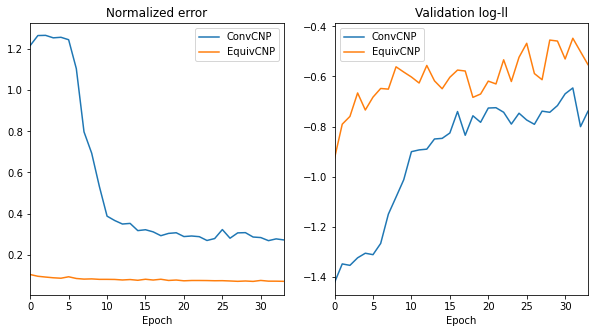

In [10]:
train_dict_cnn_1=torch.load('../../Experiments/GP_div_free/Saved_Models/Equiv_error/Equiv_error_Final_1_CNN_2020_09_06_06_54',map_location=torch.device('cpu'))
train_dict_cnn_2=torch.load('../../Experiments/GP_div_free/Saved_Models/Equiv_error/Equiv_error_Final_2_CNN_2020_09_06_06_57',map_location=torch.device('cpu'))
train_dict_equiv_1=torch.load('../../Experiments/GP_div_free/Saved_Models/Equiv_error/Final_Equiv_error_1_C16_2020_09_07_06_10',map_location=torch.device('cpu'))
train_dict_equiv_2=torch.load('../../Experiments/GP_div_free/Saved_Models/Equiv_error/Final_Equiv_error_2_C16_2020_09_07_06_48',map_location=torch.device('cpu'))

equiv_loss_train_cnn_1=train_dict_cnn_1['equiv_loss_train']
equiv_loss_train_cnn_2=train_dict_cnn_2['equiv_loss_train']
equiv_loss_train_equiv_1=train_dict_equiv_1['equiv_loss_train']
equiv_loss_train_equiv_2=train_dict_equiv_2['equiv_loss_train']


log_ll_history_cnn=0.5*(np.array(train_dict_cnn_1['val_log ll_history'])+np.array(train_dict_cnn_2['val_log ll_history']))
log_ll_history_equiv=0.5*(np.array(train_dict_equiv_1['val_log ll_history'])+np.array(train_dict_equiv_2['val_log ll_history']))

loss_mean_norm_cnn=0.5*(np.array(equiv_loss_train_cnn_1['loss_mean_norm'])+np.array(equiv_loss_train_cnn_2['loss_mean_norm']))
loss_mean_norm_equiv=0.5*(np.array(equiv_loss_train_equiv_1['loss_mean_norm'])+np.array(equiv_loss_train_equiv_2['loss_mean_norm']))

loss_mean_cnn=0.5*(np.array(equiv_loss_train_cnn_1['loss_mean'])+np.array(equiv_loss_train_cnn_2['loss_mean']))
loss_mean_equiv=0.5*(np.array(equiv_loss_train_equiv_1['loss_mean'])+np.array(equiv_loss_train_equiv_2['loss_mean']))

fig,ax=plt.subplots(ncols=2,nrows=1,figsize=(10,5))

ax[0].set_title("Normalized error")
ax[0].plot(loss_mean_norm_cnn,label='ConvCNP')
ax[0].plot(loss_mean_norm_equiv,label='EquivCNP')
ax[0].set_xlabel("Epoch")
ax[0].legend()
ax[0].set_xlim(0,33)
#ax[1].plot(loss_mean_cnn,label='ConvCNP')
#ax[1].plot(loss_mean_equiv,label='EquivCNP')
#ax[1].legend()
#ax[1].set_xlabel("Epoch")

#ax[1].set_xlim(0,33)
#ax[1].set_title("Error")
ax[1].plot(log_ll_history_cnn,label='ConvCNP')
ax[1].plot(log_ll_history_equiv,label='EquivCNP')
ax[1].set_title("Validation log-ll")
ax[1].legend()
ax[1].set_xlim(0,33)
ax[1].set_xlabel("Epoch")

plt.savefig("Equivariance_Plot_Final_2.pdf",pad_inches=0.,bbox_inches='tight')


In [5]:
G_act=gspaces.Rot2dOnR2(N=8)
feature_in=G_CNN.FieldType(G_act,[G_act.irrep(1)])
train_dict=torch.load('../../Experiments/GP_div_free/Saved_Models/Illustration_Models/D8_choice_first_2020_09_02_18_07',map_location=torch.device('cpu'))
equiv_cnp=EquivCNP.EquivCNP.create_model_from_dict(train_dict['CNP_dict'])
FILEPATH="../../Tasks/GP_Data/GP_div_free_circle/"
test_dataset=DataLoader.give_GP_div_free_data_set(5,30,'test',file_path=FILEPATH)


In [6]:
def equiv_plot(CNP,G_act,feature_in,dataset,axs,plot_trans=False,plot_stable=True,title='',scale=0.7):
    '''
    G_act - 
    feature_in - 
    CNP - a CNP-like model taking context sets and is evaluated on target sets
    '''
    with torch.autograd.no_grad():
        testing_elements=list(G_act.testing_elements)
        rand_ind=np.random.randint(low=0,high=len(testing_elements))
        g=testing_elements[rand_ind]
        #Get random context and target set:        
        x_context,y_context,x_target,y_target=dataset.get_rand_batch(batch_size=1,cont_in_target=False)
        Means,Sigmas=CNP.forward(x_context,y_context,x_target)
        
        #Get squared norm per batch element as a normalizer:
        normalizer_mean=torch.abs(Means).sum(2).mean(1)
        normalizer_sigma=torch.abs(Sigmas).sum([2,3]).mean(1)

        #Get input representation of g and transform context:
        M=torch.tensor(feature_in.representation(g),dtype=torch.get_default_dtype())
        trans_x_context=torch.matmul(x_context,M.t())
        trans_y_context=torch.matmul(y_context,M.t())
        trans_x_target=torch.matmul(x_target,M.t())
        
        #Get means and variances of transformed context and transformed target:
        Means_trans,Sigmas_trans=CNP.forward(trans_x_context,trans_y_context,trans_x_target)
        #Get transformed  means and variances:
        trans_Means=torch.matmul(Means,M.t())
        trans_Sigmas=torch.matmul(M,torch.matmul(Sigmas_trans,M.t()))

        #Get the difference:
        Diff_means=Means_trans-trans_Means
        Diff_sigmas=Sigmas_trans-trans_Sigmas

        #Get the loss for the current iteration:
        loss_mean=torch.abs(Diff_means).sum(2).mean([0,1])
        loss_sigma=torch.abs(Diff_sigmas).sum([2,3]).mean([0,1])

        loss_mean_normalized=(torch.abs(Diff_means).sum(2).mean(1)/normalizer_mean).mean()
        loss_sigma_normalized=(torch.abs(Diff_sigmas).sum([2,3]).mean(1)/normalizer_sigma).mean()

        
        #if plot_trans:
        #    sup_title=title+"Output of transformed input | "+"Group: "+self.G_act.name+ "  |  Element: "+str(g)+"| Loss mean: "+str(loss_mean_it.detach().item())\
        #        +"| Loss sigma: "+str(loss_sigma_it.detach().item())
        #    axs[0]

        if plot_stable:
            back_Means_trans=torch.matmul(Means_trans,M)
            back_Sigmas_trans=torch.matmul(M.t(),torch.matmul(Sigmas_trans,M))
            sup_title=title+"Back transformed output of transformed input | "+"Group: "+G_act.name+ "  |  Element: "+str(g)+"| Loss mean: "+str(loss_mean.detach().item())\
                +"| Loss sigma: "+str(loss_sigma.detach().item())
            Eval.plot_context_and_VF(axs[0][0],x_context[0],y_context[0],x_target[0],Means[0],scale=scale,color='green',facecolor=None)
            Eval.plot_context_and_VF(axs[0][1],trans_x_context[0],trans_y_context[0],trans_x_target[0],Means_trans[0],scale=scale,color='blue',facecolor=None)
            Eval.compare_VF(axs[1][0],x_context[0],x_target[0],Means[0],back_Means_trans[0],scale=scale,color_1='green',color_2='blue')
            
        out_dict={'loss_mean': loss_mean.item(),'loss_mean_normalized': loss_mean_normalized.item(),
                    'loss_sigma': loss_sigma.item(), 'loss_sigma_normalized': loss_sigma_normalized.item()}
        #Get mean aggregrated loss:
        return(out_dict)



{'loss_mean': 0.03773874416947365,
 'loss_mean_normalized': 0.08911746740341187,
 'loss_sigma': 0.06301040947437286,
 'loss_sigma_normalized': 0.26687803864479065}

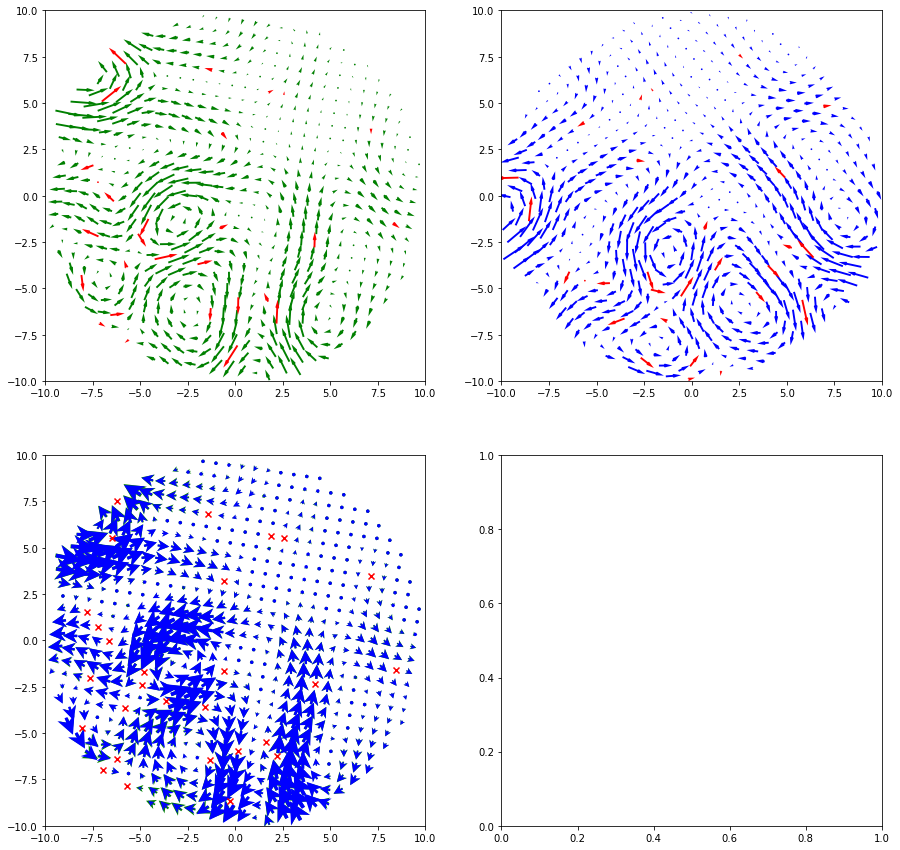

In [17]:
fig,ax=plt.subplots(nrows=2,ncols=2,figsize=(15,15))
equiv_plot(equiv_cnp,G_act,feature_in,test_dataset,ax)